# Эксперементальный метод аугментации данных при помощи модели Stable Diffusion

Для увеличения объема примеров обнаружения объектов в датасете, предлагаем метод который при помощи модели Stable Diffusion может в значительное количество раз увеличить объем, предлагая различного рода объекты. 

Для более лучшей генерации необходимо сделать файнтюнинг модели, для этого создадим собственный датасет для файнтюнинга. Возьмем пример датасета `lambdalabs/pokemon-blip-captions`, и наш датасет `object detection` в формате `COCO` и проведем `promt engeniring` чо бы сформировать датасет для файнтюнинга `Stable Diffusion`

In [1]:
from datasets import load_dataset, Dataset, load_from_disk
from pycocotools.coco import COCO
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from tqdm.notebook import tqdm

In [23]:
ds = load_dataset("lambdalabs/pokemon-blip-captions", split="train")
sample = ds[0]

Using custom data configuration lambdalabs--pokemon-blip-captions-baa94796864cc987


KeyboardInterrupt: 

In [ ]:
sample['image'].resize((256, 256))

In [ ]:
sample["text"]

Формат к которому необходимо прийти это словарь 

```
{
'image':Pillow.Image,
'text':promt_text
}
```

Взглянем на наш датасет с `object detection`  в  формат COCO. 

In [2]:
ann_file = '../dataset/new_pipe/result.json'
dataset_path = '../dataset/new_pipe/images'

In [3]:
coco = COCO(ann_file)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


Посмотрим какие категории есть

In [4]:
cats = coco.loadCats(coco.getCatIds())
nms=[cat['name'] for cat in cats]
print('COCO Категории: \n{}'.format(' '.join(nms)))

COCO Категории: 
Выход трубы из ряда Крип Разрыв Свищ Трещина


Взглянем, а есть ли вообще изображения на которых могут присудствовать несколько классов однавременно

In [5]:
catIds = coco.getCatIds(catNms=['Homer', 'Marge', 'Lisa']) # Получаем те id которые содержат выбранные нами категории
imgIds = coco.getImgIds(catIds=catIds ) # получаем изображения где есть наши категории 
img = coco.loadImgs(imgIds[0])[0] # получаем первое изображение из выбранных
img_path = img["file_name"].replace("\\", "/") # делаем замену windows на linux пути 

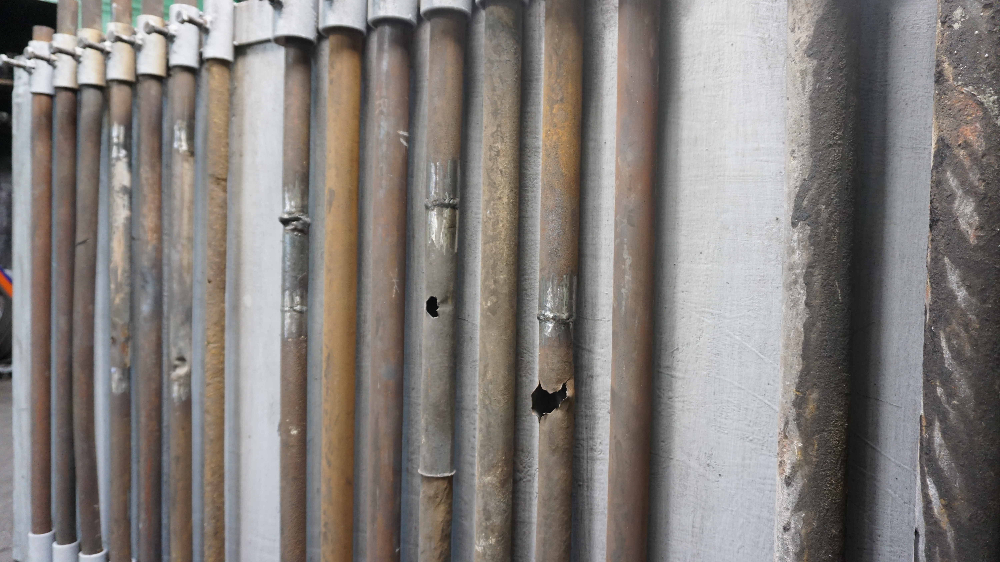

In [6]:
im = Image.open(f"{dataset_path}/{img_path}")
im

Наложим аннотации, на изображение

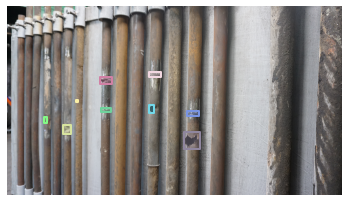

In [7]:
plt.imshow(im); plt.axis('off')
annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
anns = coco.loadAnns(annIds)
coco.showAnns(anns, draw_bbox=True)

И поскольку у нас есть фото где могут быть несколько объектов разом, необходимо обрезать объект

(-0.5, 219.5, 123.5, -0.5)

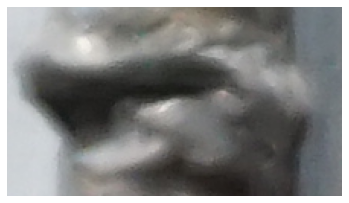

In [8]:
x, y, w,h = [int(x) for x in anns[0]['bbox']]
im_np = np.array(im)[y:y+h, x:x+w]
plt.imshow(im_np); plt.axis('off')

Поэтому мы будем идти по изображениям и если в них есть несколько классов, то будем обрезать. При обрезаении изображение неоходимо сделать кроп примерно в 5% от всего изображения. 

In [9]:
imgs = coco.imgs

In [10]:
imgs = list(imgs.values())

In [11]:
len(imgs)

201

In [12]:
labelid2text = {0:'pipe exit from row', 1: 'creep', 2:'gap', 3:'fistula', 4:'crack'} # Конвертация id класса в название

Можно использовать несколько promt, на одно изображение описаывая детально объект, вставляя всего лишь его класс. Для этого создадим шаблон и фунцию которая будет генерировать. 

In [13]:
PROMT_TEMAPLTE = [
    'Photo of a <OBJ> on a metal pipe',
    '<OBJ> on a metal pipe'
]

In [14]:
def generate_promt(obj:str):
    return [x.replace('<OBJ>', obj) for x in PROMT_TEMAPLTE]

In [15]:
SCALE_PADDING_PERCENT = 0.05

In [16]:
new_dataset = []
for img in tqdm(imgs):
    ann_id = coco.getAnnIds(imgIds=img['id'], iscrowd=None)
    ann_img = coco.loadAnns(ann_id)
    img_path = img["file_name"].replace("\\", "/") # делаем замену windows на linux пути
    print(img_path)
    img_org = Image.open(f"{dataset_path}/{img_path}")
    org_w, org_h = img_org.size
    padding_w, padding_h = int(org_w*SCALE_PADDING_PERCENT), int(org_h*SCALE_PADDING_PERCENT)
    for ann in ann_img:
        x, y, w,h = [int(x) for x in ann['bbox']]
        crop_y1, crop_y2 = y-padding_h, y+h+padding_h
        crop_x1, crop_x2 = x-padding_w, x+w+padding_w
        if crop_x2 > org_w:
            crop_x2 = org_w
        if crop_y2 > org_h:
            crop_y2 = org_h
        if crop_x1 < 0:
            crop_x1 = 0
        if crop_y1 < 0:
            crop_y1 = 0
        
        im_np = np.array(img_org)[ crop_y1:crop_y2, crop_x1:crop_x2]
        cr_img = Image.fromarray(im_np)
        generated_promt = generate_promt(labelid2text[ann['category_id']])
        for promt in generated_promt:
            new_dataset.append({
                'text': promt,
                'image': cr_img
            })

  0%|          | 0/201 [00:00<?, ?it/s]

DSC00023_13b9.JPG
DSC00031_b311.JPG
DSC00008_554a.JPG
DSC00017_dc79.JPG
DSC00003_crop_1-1_6f16.jpg
IMG_8850_d0f9.JPG
IMG_8843_65fd.JPG
IMG_8851_5780.JPG
IMG_8848_0b9b.JPG
IMG_8836_b363.JPG
IMG_8835_e580.JPG
DSC00012_5736.JPG
DSC00030_6c53.JPG
DSC00027_8c63.JPG
DSC00009_d438.JPG
DSC00011_bbd4.JPG
DSC00018_4acc.JPG
IMG_8855_e649.JPG
IMG_8846_6488.JPG
IMG_8842_7246.JPG
IMG_8845_3f77.JPG
DSC00024_c479.JPG
2021-01-27%252015-08-31_dd3b.JPG
IMG_8906_9778.JPG
IMG_8901_c668.JPG
IMG_8895_254e.JPG
IMG_8859_edd8.JPG
IMG_8856_e216.JPG
IMG_8849_d860.JPG
IMG_8844_cf21.JPG
IMG_8833_c909.JPG
DSC00092_73fa.JPG
DSC00007_2de5.JPG
DSC00006_bfd9.JPG
DSC00005_7cea.JPG
DSC00003_fa26.JPG
DSC00003_crop_27cb.jpg
DSC00002_9877.JPG
DSC00002_crop_d1d2.jpg
DSC00002_crop_1-2_60cc.jpg
DSC00002_crop_1-2-2_92cd.jpg
DSC00001_crop_874d.jpg
DSC00001_crop_1-2-2_1b03.jpg
DSC00001_crop_1-1_4a24.jpg
2021-01-27%252015-08-53_b8e8.JPG
2021-01-27%252015-08-42_1960.JPG
2021-01-27%252015-08-33_ab05.JPG
2021-01-27%252015-08-13_4438.J

In [17]:
%%time
dataset = Dataset.from_list(new_dataset) # Загрузим датасет из списка в объект 

CPU times: user 2min 39s, sys: 437 ms, total: 2min 39s
Wall time: 2min 39s


In [18]:
len(dataset) # Посмотрим на объем класса 

1646

In [19]:
dataset.save_to_disk('../dataset/promt_datasets') # Сохраним на диск датасе

In [20]:
new_dataset = Dataset.load_from_disk('../dataset/promt_datasets')

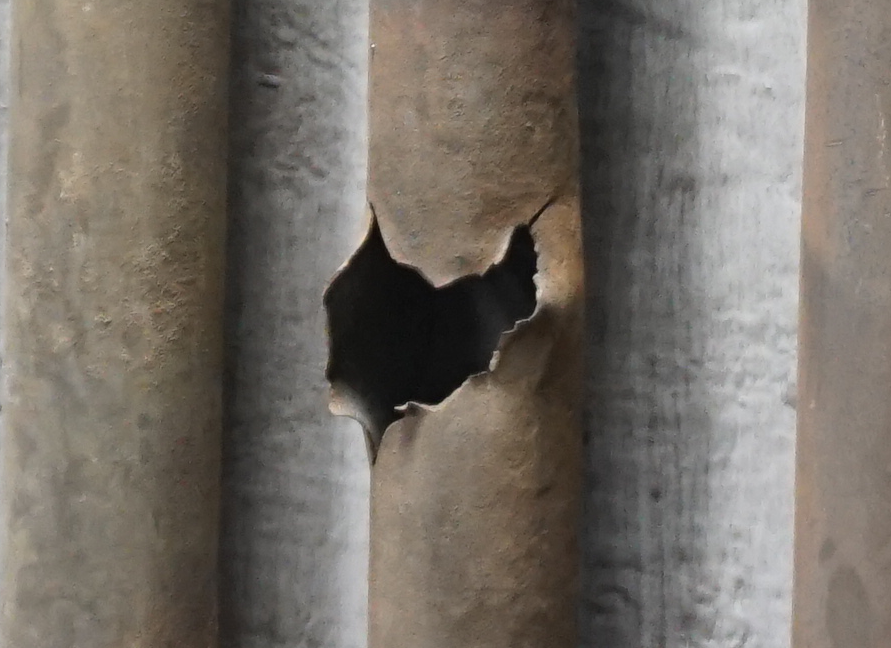

In [24]:
new_dataset[7]['image']

In [25]:
new_dataset[7]['text']

'gap on a metal pipe'